In [12]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from sparseopt.utils.plot import plot_3d
from sparseopt.attns.act_sparse_nbits import MFSparseNbits

In [7]:
data_file = "/ssd01/workspace/sglang/exp/data/query/layer0.pt"
data = torch.load(data_file, map_location='cpu')
query = data[0]

/tmp/ipykernel_2986844/3640806499.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  data = torch.load(data_file, map_location='cpu')


In [6]:
tool = MFSparseNbits(
    bank_size=64,
    sparsity=0.,
    quant_mode="per_bank",
    num_bits={"high": 8, "low": 0},
    quant_symmetric=True,
    quant_masked=True,
)

In [23]:
image_file = data_file.replace('.pt', '.png')
query_plt = query #[:2, :64]
query_mf = tool(query_plt)
infos = [
    # layer column
    # {
    #     f"head {i}\n query unrope positive\ndense": q[:, :-64].cpu().float().clamp(min=0).abs().numpy()
    #     for i, q in enumerate(query_plt)
    # },
    # {
    #     f"head {i}\n query unrope positive\nper_bank 8bit": q[:, :-64].cpu().float().clamp(min=0).abs().numpy()
    #     for i, q in enumerate(query_mf)
    # },
    # {
    #     f"head {i}\n query unrope negative\ndense": q[:, :-64].cpu().float().clamp(max=0).abs().numpy()
    #     for i, q in enumerate(query_plt)
    # },
    # {
    #     f"head {i}\n query unrope negative\nper_bank 8bit": q[:, :-64].cpu().float().clamp(max=0).abs().numpy()
    #     for i, q in enumerate(query_mf)
    # },
    # {
    #     f"head {i}\n query rope positive\ndense": q[:, -64:].cpu().float().clamp(min=0).abs().numpy()
    #     for i, q in enumerate(query_plt)
    # },
    # {
    #     f"head {i}\n query rope positive\nper_bank 8bit": q[:, -64:].cpu().float().clamp(min=0).abs().numpy()
    #     for i, q in enumerate(query_mf)
    # },
    # {
    #     f"head {i}\n query rope negative\ndense": q[:, -64:].cpu().float().clamp(max=0).abs().numpy()
    #     for i, q in enumerate(query_plt)
    # },
    # {
    #     f"head {i}\n query rope negative\nper_bank 8bit": q[:, -64:].cpu().float().clamp(max=0).abs().numpy()
    #     for i, q in enumerate(query_mf)
    # }

    # layer row
    { 
        f"head {i}\n query unrope positive\ndense": q_plt[:, :-64].cpu().float().clamp(min=0).abs().numpy(),
        f"head {i}\n query unrope positive\nper_bank 8bit": q_mf[:, :-64].cpu().float().clamp(min=0).abs().numpy(),
        f"head {i}\n query unrope negative\ndense": q_plt[:, :-64].cpu().float().clamp(max=0).abs().numpy(),
        f"head {i}\n query unrope negative\nper_bank 8bit": q_mf[:, :-64].cpu().float().clamp(max=0).abs().numpy(),
        f"head {i}\n query rope positive\ndense": q_plt[:, -64:].cpu().float().clamp(min=0).abs().numpy(),
        f"head {i}\n query rope positive\nper_bank 8bit": q_mf[:, -64:].cpu().float().clamp(min=0).abs().numpy(),
        f"head {i}\n query rope negative\ndense": q_plt[:, -64:].cpu().float().clamp(max=0).abs().numpy(),
        f"head {i}\n query rope negative\nper_bank 8bit": q_mf[:, -64:].cpu().float().clamp(max=0).abs().numpy(),
    }
    for i, (q_plt, q_mf) in enumerate(zip(query_plt, query_mf))
]
plot_3d(infos, image_file, image_size=5)

### Ploting head 0
 query unrope positive
dense with shape (128, 512)... ###
### Ploting head 0
 query unrope positive
per_bank 8bit with shape (128, 512)... ###
### Ploting head 0
 query unrope negative
dense with shape (128, 512)... ###
### Ploting head 0
 query unrope negative
per_bank 8bit with shape (128, 512)... ###
### Ploting head 0
 query rope positive
dense with shape (128, 64)... ###
### Ploting head 0
 query rope positive
per_bank 8bit with shape (128, 64)... ###
### Ploting head 0
 query rope negative
dense with shape (128, 64)... ###
### Ploting head 0
 query rope negative
per_bank 8bit with shape (128, 64)... ###
### Ploting head 1
 query unrope positive
dense with shape (128, 512)... ###
### Ploting head 1
 query unrope positive
per_bank 8bit with shape (128, 512)... ###
### Ploting head 1
 query unrope negative
dense with shape (128, 512)... ###
### Ploting head 1
 query unrope negative
per_bank 8bit with shape (128, 512)... ###
### Ploting head 1
 query rope positive


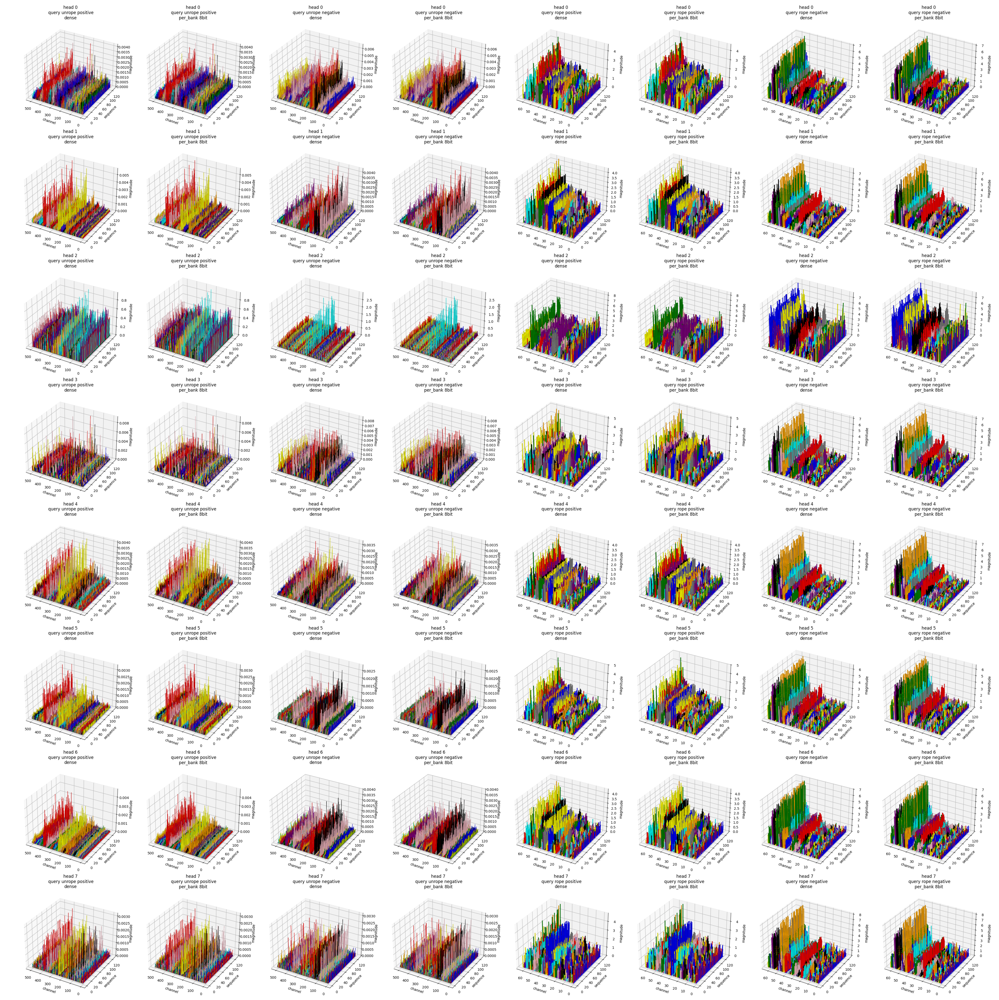

In [27]:
image = mpimg.imread(image_file)

fig = plt.figure(figsize=(80, 80))
# 显示图片
plt.imshow(image)
plt.axis('off')  # 可选：隐藏坐标轴
plt.show()